# Final Project

## BY Marvyn Bailly


### AMATH 586 Spring 2023

#### Due June 6 by 11pm on GitHub + Gradescope

1.  This project is worth 20 points.  You may discuss it with other students.  The point is for you to really understand the material and **write your own code**.

2. ***Put your name clearly on the first page of your project.***

3. Provide the code for your core algorithms in the write-up.  Provide plots to demonstrate your code.  This is a good idea even if a plot is not explicitly asked for.

4.  There are 5 extra credit points available if you want to make up some points or if you want to see how to extend your code and learn something new.  If you complete the extra credit problem you'll see something truly remarkable.  That's in my opinion, of course.

5. This project is heavily adapted from one given out by Randy LeVeque in 2008.

In [1]:
using FiniteDifferences, SparseArrays, LinearAlgebra, Plots, LaTeXStrings, FFTW, Printf

# Problem 1

Consider the ODE:

\begin{align} v'(t) = \frac 1 \epsilon g(v(t)), \quad g(v) = v (\alpha - v) (v-1) - w. \end{align}

Using the TR-BDF-2 method,

$$U^* = U^n + \frac k 4 (f(U^n) + f(U^*)),\\
U^{n+1} = \frac 1 3 \left( 4 U^* -U^n + k f(U^{n+1})\right),$$

solve this ODE and verify that the method is indeed second-order accurate at $t = 0.1$.  Use $v(0) = 0.3$, $\alpha= 0.5$, $w = 0.1$ and $\epsilon = 0.01$ as your parameters.

Note that you have to solve two nonlinear systems at each time step.  The first one requires you to solve

$$ G_1(u) = 0, \quad G_1(u) = u - U^n - \frac k 4 (f(U^n) + f(u)), \quad G_1'(u) = 1 - \frac k 4 f'(u).$$

The second is given by

$$ G_2(u) = 0, \quad G_2(u) = u - \frac 1 3 \left( 4 U^* -U^n + k f(u)\right), \quad G_2'(u) = 1 - \frac k 3 f'(u).$$

It is highly recommended that your write a function `TRBDF2(U,w,k)` that advances the solution one time step.  This function may take in the `max_iter` and `tol` for Newton's method as well.

Let's define Newton's method

In [251]:
function Newton(U, f, Df, max_iter, tol)
    for j = 1:max_iter
        U = U .- f(U) ./ Df(U)
        if maximum(abs.(f(U))) < tol
            break
        end
    end
    return U
end

Newton (generic function with 1 method)

Now we define the TRBDF function

In [252]:
function TRBDF2(U, w, k, max_iter, tol)
    function G1(u)
        u - U - k / 4 * (f(U) + f(u))
    end
    function G1_prime(u)
        1 - k / 4 * f_prime(u)
    end
    function G2(u)
        u - 1 / 3 * (4 * Us - U + k * f(u))
    end
    function G2_prime(u)
        1 - k / 3 * f_prime(u)
    end
    function g(u)
        u * (α - u) * (u - 1) - w
    end

    function f(x)
        (1 / ϵ) * g(x)
    end

    function f_prime(u)
        (1 / ϵ) * (2 * u * α - α - 3 * u^2 + 2 * u)
    end


    Us = Newton(U, G1, G1_prime, 300, 1e-10)
    U = Newton(Us, G2, G2_prime, 300, 1e-10)
end

TRBDF2 (generic function with 2 methods)

Here is the solver

In [253]:
function solve_v(w, ϵ, α, k, v, T)
    n = convert(Int64, ceil(T / k))
    sols = zeros(n + 1)
    sols[1] = v

    for i = 2:(n+1)
        v = TRBDF2(v, w, k, 300, 1e-10)
        sols[i] = v
    end

    return sols, 0:k:T
end

solve_v (generic function with 1 method)

Let's see what the solution looks like

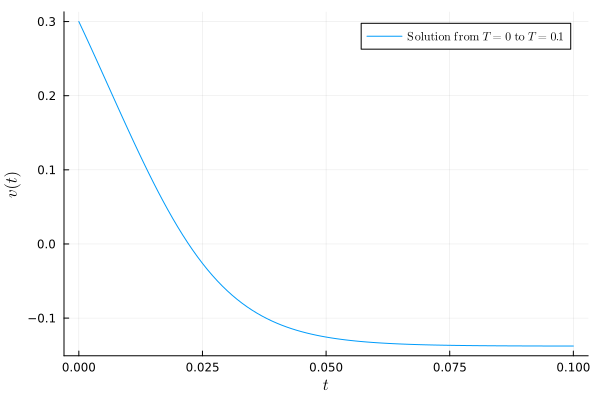

"c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\pdf\\images\\1-sol.png"

In [256]:
w = 0.1
ϵ = 0.01
α = 0.5
k = 0.001
v = 0.3
T = 0.1

sols = solve_v(w, ϵ, α, k, v, T)

graph = plot(sols[2], sols[1], xlabel=L"t", ylabel=L"v(t)", label=L"\mathrm{Solution}~\mathrm{from}~T=0~\mathrm{to}~T=0.1")
display(graph)
savefig(graph, joinpath("..", "pdf", "images", "1-sol.png"))

Now let's compare the convergence

Lets make a "true" solution using a small $k$ value

In [257]:
w = 0.1
ϵ = 0.01
α = 0.5
v = 0.3
T = 0.1
k = T * 2^(-10)
true_sol = solve_v(w, ϵ, α, k, v, T)[1][end]

-0.1377021375325683

And now we can compare the error between the "true" solution and increasingly small $k$ values

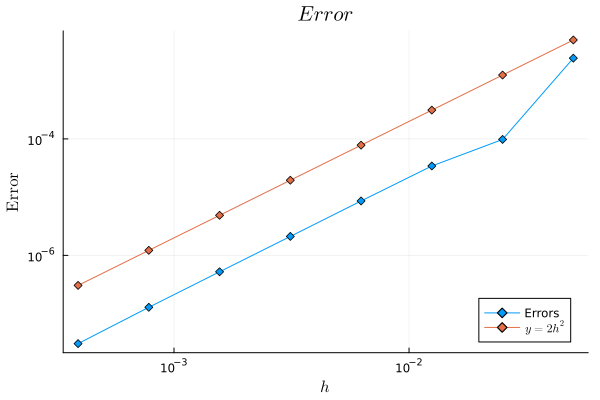

"c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\pdf\\images\\1-err.png"

In [258]:
errs = [abs(true_sol - solve_v(w, ϵ, α, T / (2^(j)), v, T)[1][end]) for j = 1:8]
hs = [T / (2^(j)) for j = 1:8]
plot(hs, errs, yaxis=:log, xaxis=:log, label="Errors", markershape=:diamond, legend=:bottomright)
graph = plot!(hs, 2hs .^ 2, title=L"Error", label=L"y = 2h^2", xlabel=L"h", ylabel=L"\mathrm{Error}", markershape=:diamond)
display(graph)
savefig(graph, joinpath("..", "pdf", "images", "1-err.png"))

Since the errors decrease with $h^2$ we see that this method is indeed second order accurate!

# Problem 2

The previous ODE becomes more interesting when it is coupled with another differential equation that evolves $w$:


$\begin{align} v'(t) &= \frac 1 \epsilon \left( g(v(t)) - w(t) + I_a \right), \quad g(v) = v (\alpha - v) (v-1),\\
w'(t) &= \beta v(t) - \gamma w(t).\end{align}$

This is a simple model that exhibits many features of excitable media, and is a simplification of the famous Hodgkin-Huxley equations that are a model for propagation in neuronal systems.  In this system $v(t)$ models the membrane potential while $w(t)$ models the concentration of an ion.

Since we have already gone through the effort to solve the above system, we would like to be able to reuse our code.  Write the system as

$
\begin{align}
\begin{bmatrix} v'(t) \\ w'(t) \end{bmatrix} = \mathcal A\left(\begin{bmatrix} v(t) \\ w(t) \end{bmatrix} \right) + \mathcal B\left(\begin{bmatrix} v(t) \\ w(t) \end{bmatrix} \right)
\end{align}
$

where
$
\begin{align}
\mathcal A \left(\begin{bmatrix} v \\ w \end{bmatrix} \right) &= \begin{bmatrix} \frac 1 \epsilon \left( g(v) - w+ I_a \right) \\ 0\end{bmatrix}, \\
\mathcal B \left(\begin{bmatrix} v \\ w \end{bmatrix} \right) &= \begin{bmatrix} 0 \\ \beta v - \gamma w\end{bmatrix}.
\end{align}
$
In the notation of (11.24) in the text, the function `TRBDF2(V,W,k)` described in the previous problem is the function $\mathcal N_{\mathcal A}(V,W,k)$.  Construct the analogous function for $\mathcal N_{\mathcal B}(V,W,k)$, call it `RK2(V,W)` using the second-order Runge-Kutta method (5.30).

Then `Julia` code for Strang splitting (11.24) is given by

```Julia
W[i] = RK2(V[i-1],W[i-1],k/2)
V[i] = TRBDF2(V[i-1],W[i],k)
W[i] = RK2(V[i],W[i],k/2)
```

This should be easily adapted to the language of your choosing.

Using

\begin{align*}
\alpha = 0.3, \quad \beta = 1, \quad \gamma = 1, \quad I_a = 0, \quad \epsilon = 0.001,
\end{align*}

with initial data

\begin{align*}
v(0) = v_0, \quad w(0) = 0,
\end{align*}

the solution of the ODE system exhibits two distinct behaviors:

1. If $v_0 = 0.31$ then $v(t)$ rapdily rises near $v = 1$ and then decays to the stable steady state $v = w = 0$.

2. If $v_0 = 0.29$ the the solution decays directly to the steady state $v = w = 0$.

Verify plot these two solutions. Numerically, verify that your method is second-order accurate at $t = 0.25$ when $v_0 = 0.29$.


Lastly, change $I_a = 0.2$ and plot the solution with $v_0 = 0$ until $t = 10$.

Update the functions

In [262]:
function Newton(U, f, Df, max_iter, tol)
    for j = 1:max_iter
        U = U .- f(U) ./ Df(U)
        if maximum(abs.(f(U))) < tol
            break
        end
    end
    return U
end

Newton (generic function with 1 method)

In [263]:
function TRBDF2(U, w, k, max_iter, tol)
    function G1(u)
        u .- U .- k / 4 .* (f(U) .+ f(u))
    end

    function G1_prime(u)
        1 .- k / 4 .* f_prime(u)
    end

    function G2(u)
        u .- 1 / 3 .* (4 .* Us .- U .+ k .* f(u))
    end

    function G2_prime(u)
        1 .- k / 3 .* f_prime(u)
    end
    function g(v)
        v .* (α .- v) .* (v .- 1)
    end

    function f(x)
        (1 ./ ϵ) .* (g(x) .- w .+ Ia)
    end

    function f_prime(u)
        (1 ./ ϵ) .* (2 .* u .* α .- α .- 3 .* u^2 .+ 2 .* u)
    end

    Us = Newton(U, G1, G1_prime, 300, 1e-10)
    U = Newton(Us, G2, G2_prime, 300, 1e-10)
end

TRBDF2 (generic function with 2 methods)

Make an RK2 function

In [264]:
function RK2(V, W, k)
    function h(W, V)
        β * V - γ * W
    end
    Wtemp = W + (k / 2) * h(W, V)
    W = W + k * h(Wtemp, V)
end

RK2 (generic function with 1 method)

Create the solver

In [265]:
function solve_Hodgkin(k, T, vInit, wInit)

    n = convert(Int64, ceil(T / k))

    W = zeros(n + 1)
    V = zeros(n + 1)

    V[1] = vInit
    W[1] = wInit

    for i = 2:(n+1)
        W[i] = RK2(V[i-1], W[i-1], k / 2)
        V[i] = TRBDF2(V[i-1], W[i], k, 300, 1e-10)
        W[i] = RK2(V[i], W[i], k / 2)
    end

    return (V, W, 0:k:T)
end

solve_Hodgkin (generic function with 1 method)

Define the parameters

In [266]:
α = 0.3
β = 1
γ = 1
Ia = 0
ϵ = 0.001
k = 0.001

0.001

Let's see what happens when $v_0 = 0.31$

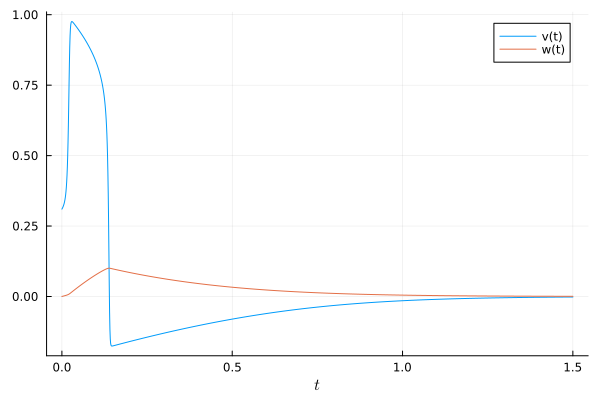

"c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\pdf\\images\\2-sol1.png"

In [267]:
T = 1.50
vInit = 0.31
wInit = 0


sol = solve_Hodgkin(k, T, vInit, wInit)

graph = plot(sol[3], sol[1], xlabel=L"t", label="v(t)")
graph = plot!(sol[3], sol[2], label="w(t)")

display(graph)
savefig(graph, joinpath("..", "pdf", "images", "2-sol1.png"))

We see the expected behavior!

Let's see what happens when $v_0 = 0.29$

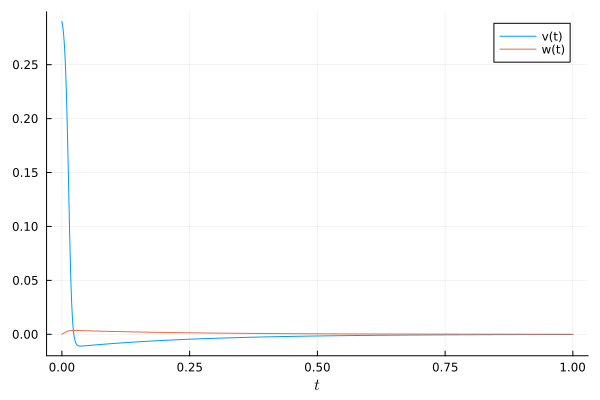

"c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\pdf\\images\\2-sol2.png"

In [268]:
vInit = 0.29
wInit = 0
T = 1

sol = solve_Hodgkin(k, T, vInit, wInit)

graph = plot(sol[3], sol[1], xlabel=L"t", label="v(t)")
graph = plot!(sol[3], sol[2], label="w(t)")

display(graph)
savefig(graph, joinpath("..", "pdf", "images", "2-sol2.png"))

We see the expected behavior

We now verify that the method is second order accurate at $T = 0.25$ and $v_0 = 0.29$. 

In [269]:
T = 0.25
vInit = 0.29
wInit = 0

k = T * 2^(-16)
v_true_sol = solve_Hodgkin(k, T, vInit, wInit)[1][end]
w_true_sol = solve_Hodgkin(k, T, vInit, wInit)[2][end]

0.001381996920477696

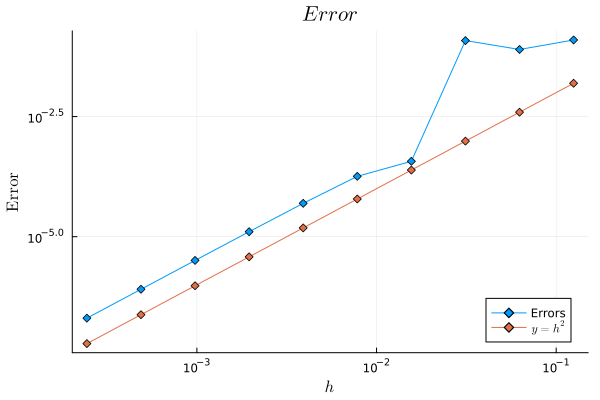

"c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\pdf\\images\\2-err.png"

In [270]:
v_errs = [abs(v_true_sol - solve_Hodgkin(T / (2^(j)), T, vInit, wInit)[1][end]) for j = 1:10]
w_errs = [abs(w_true_sol - solve_Hodgkin(T / (2^(j)), T, vInit, wInit)[2][end]) for j = 1:10]
hs = [T / (2^(j)) for j = 1:10]




graph = plot(hs, maximum([v_errs, w_errs]), yaxis=:log, xaxis=:log, label="Errors", markershape=:diamond, legend=:bottomright)
graph = plot!(hs, hs .^ 2, title=L"Error", label=L"y = h^2", xlabel=L"h", ylabel=L"\mathrm{Error}", markershape=:diamond)

display(graph)
savefig(graph, joinpath("..", "pdf", "images", "2-err.png"))

Looks second order!

Lastly, change $I_a = 0.2$ and plot the solution with $v_0 = 0$ until $t = 10$.

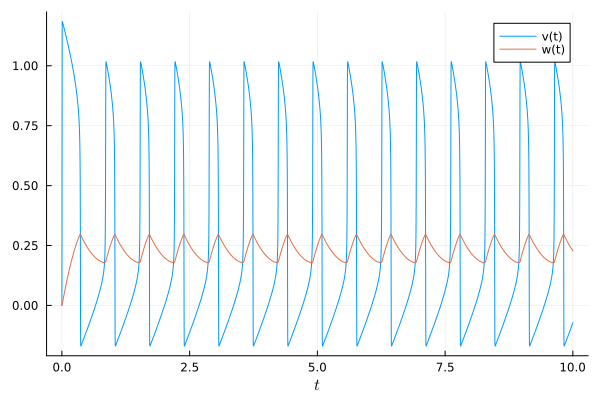

"c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\pdf\\images\\2-final.png"

In [271]:
Ia = 0.2
vInit = 0
T = 10
k = 0.001


sol = solve_Hodgkin(k, T, vInit, wInit)
graph = plot(sol[3], sol[1], xlabel=L"t", label="v(t)")
graph = plot!(sol[3], sol[2], label="w(t)")
display(graph)
savefig(graph, joinpath("..", "pdf", "images", "2-final.png"))

Looks pretty dang neat!

# Problem 3

Consider the heat equation

$
\begin{align}
    v_t = \kappa v_{xx}, \quad t > 0,\quad x \in (a,b).
\end{align}
$

We impose Neumann boundary conditions $v_x(a,t) = 0 = v_x(b,t)$.  Because the boundary conditions do not directly specify $v(a,t)$ and $v(b,t)$, we need to include their approximations in our vector of unkowns.  The MOL discretization can be written as

$
\begin{align}
V'(t) = \frac{\kappa}{h^2} A V(t),
\end{align}
$

where

$
\begin{align}
V(t) = \begin{bmatrix} V_0(t)\\ V_1(t) \\ \vdots \\ V_{m+1}(t) \end{bmatrix},
\end{align}
$

and 

$
\begin{align}
A = \begin{bmatrix}
-2  & 2\\
1 & -2 & 1 \\
& 1 & -2 & 1\\
&& \ddots & \ddots & \ddots \\
&&& 1 & -2 & 1\\
&&&& 2 & -2 \end{bmatrix}.
\end{align}
$

Note:  This is derived by introducing "ghost values" $V_{-1}(t)$ and $V_{m+2}(t)$ and then enforcing the Neumann conditions via

\begin{align*}
    \frac{V_{1}(t) - V_{-1}(t)}{2h} = 0 = \frac{V_{m+2}(t) - V_{m}(t)}{2h}.
\end{align*}

These relations are used to then eliminate the ghost values from the system.  You need not derive this.  


Apply the TR-BDF-2 method to the MOL discretization and write a function `TRBDF2_heat(V)` that applies one time step of this method with time step `k`.  It is best to keep `k` fixed here because then matrices do not have to be recomputed at each time step.  With $a = 0, b = 4$, demonstrate that your code works by using the initial data

$
\begin{align}
    v(x,0) = \begin{cases} 1 &a \leq x < \frac{a+b}{2} \\
    0 & \text{otherwise}.
    \end{cases}
\end{align}
$

The integral of the solution should nearly be preserved, resulting in a long-time limit $v(x,t) \approx 1/2$ as $t \to \infty$.  Demonstrate this with $h = 0.01$, $k = h$ and $\kappa = 1$ and discuss any discrepancy you see.  It may help to choose other initial data to explain the situation.

Note: Here you are working on an interval $[a,b]$ and in this case $h$ is affected by the difference $b -a$.

Note that we can rewrite as
\begin{align*}
\left( I - \frac k 4 B \right)U^*  =  \left( I + \frac k 4 B \right) U^n,\\
\left( I - \frac k 3 B \right) U^{n+1} = \frac 1 3 \left( 4 U^* - U^n \right).
\end{align*}

Solve for one step

In [278]:
function TRBDF2_heat(U, A1, A2, A3)
    Us = A1 \ (A2 * U)
    return A3 \ ((4 / 3) * Us - (1 / 3) * U)
end

TRBDF2_heat (generic function with 2 methods)

Define two solver. One to produce solution plots and the other to make gifs

In [279]:
function solve_TRBDF2_heat(V, T)
    n = convert(Int64, ceil(T / k))
    sol = zeros(length(V), n + 1)
    sol[:, 1] = V
    for i = 2:n+1
        V = TRBDF2_heat(V)
        sol[:, i] = V
    end
    return V, sol
end

function gif_TRBDF2_heat(V, T)
    anim = Animation()
    plot(xs, V, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", T))
    plot!([a, b], [V[1], V[end]], label="BCs", seriestype=:scatter)
    frame(anim)

    t = 0
    fr = 100
    n = convert(Int64, ceil(T / k))
    tb = convert(Int64, ceil(n / (fr * T)))
    for i = 2:n+1
        t += k
        V = TRBDF2_heat(V)
        if mod(i - 1, tb) ≈ 0.0
            plot(xs, V, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("v(x,t), t = %1.2f", t))
            plot!([a, b], [V[1], V[end]], label="BCs", seriestype=:scatter)
            frame(anim)
        end
    end
    gif(anim, "3.gif")
end

gif_TRBDF2_heat (generic function with 1 method)

Let's keep $k$ fixed here as per the recommendation

In [280]:
#create matrices once
h = 0.01
k = h

A = diagm(0 => fill(-2, m + 2), 1 => fill(1, m + 1), -1 => fill(1, m + 1)) |> sparse
A[1, 2] += 1
A[end, end-1] += 1
A *= κ / h^2


A1 = I - (k / 4) * A
A2 = I + (k / 4) * A
A3 = I - (k / 3) * A;

Let's watch a movie

In [281]:
a = 0
b = 4
h = 0.01
xs = a:h:b
m = length(xs) - 2
η = x -> a ≤ abs(x) < (a + b) / 2 ? 1 : 0
V = η.(xs)
T = 5.0
κ = 1


#gif_TRBDF2_heat(V,T)

1

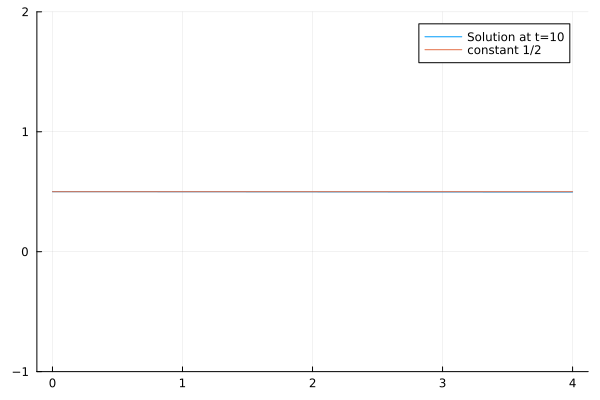

In [285]:
T = 10
sol = solve_TRBDF2_heat(V, T)[1]
graph = plot(xs, sol, ylims=[-1, 2], label="Solution at t=$T")
graph = plot!(xs, 1 / 2 * ones(length(xs)), label="constant 1/2")
display(graph)

#savefig(graph,joinpath("..","pdf","images","3-4.png"))

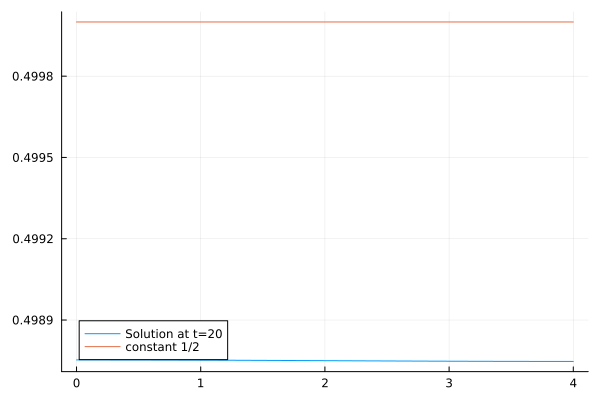

In [282]:
T = 20
sol = solve_TRBDF2_heat(V, T)[1]
graph = plot(xs, sol, label="Solution at t=$T")
graph = plot!(xs, 1 / 2 * ones(length(xs)), label="constant 1/2")
display(graph)

#savefig(graph,joinpath("..","pdf","images","3-6.png"))

In [135]:
maximum(abs.(sol - 1 / 2 * ones(length(xs))))

0.0012527925659450156

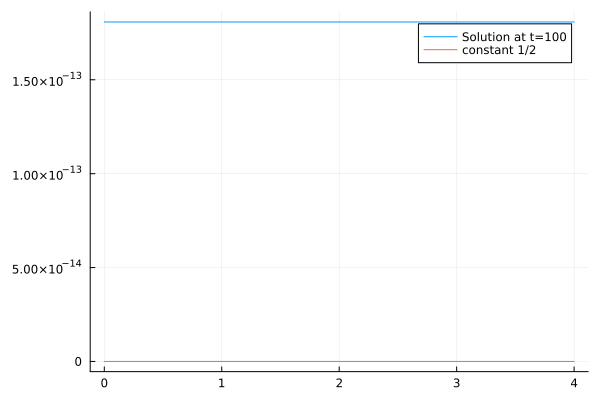

In [137]:
T = 100
η = x -> cos(0.25 * pi * x)
V = η.(xs)

sol = solve_TRBDF2_heat(V, T)[1]
graph = plot(xs, sol, label="Solution at t=$T")
graph = plot!(xs, zeros(length(xs)), label="constant 1/2")
display(graph)

In [138]:
maximum(abs.(sol - zeros(length(xs))))

1.807789142202125e-13

Trapezoid method

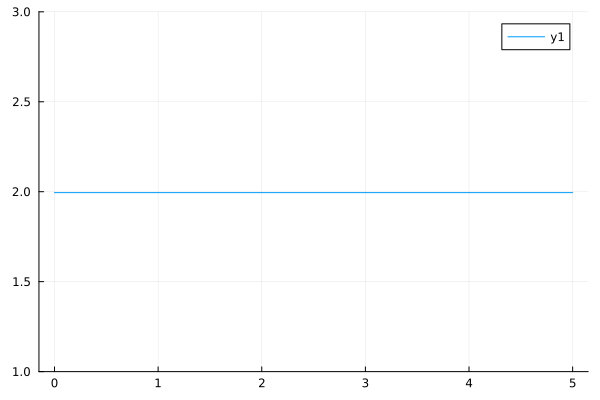

In [129]:
solve_matrix = solve_TRBDF2_heat(V, T)[2]

n = size(solve_matrix)[2]

integral_vals = zeros(n)

for i = 1:n
    integral_vals[i] = (h / 2) * (sum(solve_matrix[1:end-1, i]) + sum(solve_matrix[2:end, i]))
end


t_vec = 0:k:T
plot(t_vec, integral_vals, yaxis=[1, 3])

# Problem 4

The ODE system can be modified to allow for spatial variations: For $x \in (a,b)$

\begin{align*}
v_t(x,t) &= \kappa v_{xx}(x,t)+  \frac 1 \epsilon \left( g(v(x,t)) - w(x,t) + I_a \right), \quad g(v) = v (\alpha - v) (v-1),\\
w_t(x,t) &= \beta v(x,t) - \gamma w(x,t)\\
v_x(a,t) & = 0,\\
v_x(b,t) & = 0.
\end{align*}

Now let function `TRBDF2_heat(V)` apply one time step toward the solution of $v_t = \kappa v_{xx}$ with time step `k/2`.

Supposing that our previous code for `TRBDF2()` and `RK2()` is vectorized, Strang splitting becomes (with $I_a = 0$)

```Julia
V = TRBDF2_heat(V)
W = RK2(V,W,k/2)
V = TRBDF2(V,W,k)
W = RK2(V,W,k/2)
V = TRBDF2_heat(V)
```

Use the parameters:
\begin{align*}
h = 0.02, \quad k = h/10, \quad a = 0, \quad b = 6, \quad \alpha = 0.3,\\
\beta = 1, \quad \gamma = 1, \quad \kappa = 0.2, \quad \epsilon = 0.001.
\end{align*}
and initial data
\begin{align*}
    v(x,0) = \begin{cases} 1 &0 \leq x < 1 \\
    0 & \text{otherwise},
    \end{cases} \quad w(x,0) = 0.
\end{align*}
Solve until $t = 4$.  You should see a travelling wave develop and propagate.


In [529]:
function TRBDF2_heat(U)
    Us = A1 \ (A2 * U)
    return A3 \ ((4 / 3) * Us - (1 / 3) * U)
end

TRBDF2_heat (generic function with 2 methods)

In [530]:
function Newton(U, f, Df, max_iter, tol)
    for j = 1:max_iter
        U = U .- f(U) ./ Df(U)
        if maximum(abs.(f(U))) < tol
            break
        end
    end
    return U
end

Newton (generic function with 1 method)

In [531]:
function TRBDF2(U, w, k, max_iter, tol)
    #display(print(U))
    #display(print(w))
    function G1(u)
        u .- U .- k / 4 .* (f(U) .+ f(u))
    end

    function G1_prime(u)
        1 .- k / 4 .* f_prime(u)
    end

    function G2(u)
        u .- 1 / 3 .* (4 .* Us .- U .+ k .* f(u))
    end

    function G2_prime(u)
        1 .- k / 3 .* f_prime(u)
    end
    function g(v)
        v .* (α .- v) .* (v .- 1)
    end

    function f(x)
        (1 ./ ϵ) .* (g(x) .- w .+ Ia)
    end

    function f_prime(u)
        (1 ./ ϵ) .* (2 .* u .* α .- α .- 3 .* u .^ 2 .+ 2 .* u)
    end

    Us = Newton(U, G1, G1_prime, 300, 1e-10)
    U = Newton(Us, G2, G2_prime, 300, 1e-10)
end

TRBDF2 (generic function with 2 methods)

In [532]:
function RK2(V, W, k)
    function h(W, V)
        β * V - γ * W
    end
    Wtemp = W + (k / 2) * h(W, V)
    W = W + k * h(Wtemp, V)
end

RK2 (generic function with 1 method)

In [533]:
function gif_strange(V, W, T)
    anim = Animation()
    n = convert(Int64, ceil(T / k))

    plot(xs, V, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", T))
    plot!([a, b], [V[1], V[end]], label="BCs", seriestype=:scatter)
    plot!(xs, W, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", T))
    plot!([a, b], [W[1], W[end]], label="BCs", seriestype=:scatter)
    frame(anim)

    t = 0
    fr = 100
    n = convert(Int64, ceil(T / k))
    tb = convert(Int64, ceil(n / (fr * T)))
    for i = 2:n+1
        t += k

        #STRANGE SPLITTING
        V = TRBDF2_heat(V) #V=0
        W = RK2(V, W, k / 2)
        V = TRBDF2(V, W, k, 300, 1e-10) #V,W
        W = RK2(V, W, k / 2)
        V = TRBDF2_heat(V)

        if mod(i - 1, tb) ≈ 0.0
            plot(xs, V, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", t))
            plot!([a, b], [V[1], V[end]], label="BCs", seriestype=:scatter)
            plot!(xs, W, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", t))
            plot!([a, b], [W[1], W[end]], label="BCs", seriestype=:scatter)
            frame(anim)
        end
    end
    gif(anim, "4.gif")
end

gif_strange (generic function with 2 methods)

In [534]:
function solve_strange(V, W, T)
    n = convert(Int64, ceil(T / k))

    t = 0
    n = convert(Int64, ceil(T / k))
    for i = 2:n+1
        t += k
        #STRANG SPLITTING
        V = TRBDF2_heat(V) #V=0
        W = RK2(V, W, k / 2)
        V = TRBDF2(V, W, k, 300, 1e-10) #V,W
        W = RK2(V, W, k / 2)
        V = TRBDF2_heat(V)
    end
    return V, W
end

solve_strange (generic function with 1 method)

Define a whole ton of things

In [535]:
h = 0.02
k = h / 10
a = 0
b = 6
α = 0.3
β = 1
γ = 1
κ = 0.2
ϵ = 0.001
Ia = 0

xs = a:h:b
m = length(xs) - 2

A = diagm(0 => fill(-2, m + 2), 1 => fill(1, m + 1), -1 => fill(1, m + 1)) |> sparse
A[1, 2] += 1
A[end, end-1] += 1
A *= κ / h^2

#k/2!!
A1 = I - (k / 8) * A
A2 = I + (k / 8) * A
A3 = I - (k / 6) * A

vInit = x -> 0 ≤ x < 1 ? 1 : 0

#447 (generic function with 1 method)

┌ Info: Saved animation to c:\Users\admin\Documents\GitHub\UW\2022-2023\Spring\AMATH_586\Final Project\src\code\4.gif
└ @ Plots C:\Users\admin\.julia\packages\Plots\esM5q\src\animation.jl:156


Plots.AnimatedGif("c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\code\\4.gif")
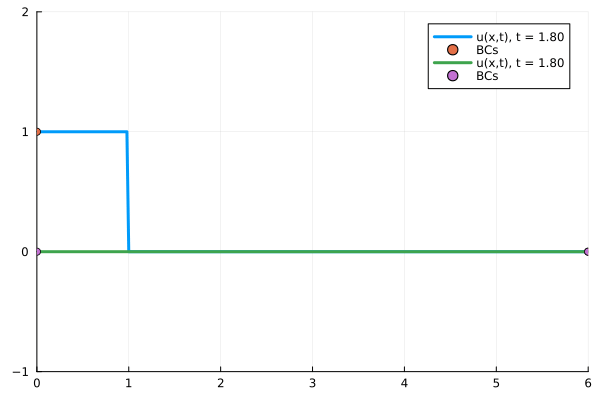

In [537]:
T = 1.8
W = zeros(m + 2)
V = zeros(m + 2)
V = vInit.(xs)
gif_strange(V, W, T)

In [343]:
T = 4

W = zeros(m + 2)
V = zeros(m + 2)
V = vInit.(xs)

sol = solve_strange(V, W, T)

([-3.128611371542631e-8, -3.128611371547043e-8, -3.128611371548203e-8, -3.128611371544596e-8, -3.128611371548922e-8, -3.128611371548489e-8, -3.1286113715459646e-8, -3.128611371547046e-8, -3.128611371545084e-8, -3.1286113715236843e-8  …  -6.8646453468856545e-6, -7.042679774374226e-6, -7.243732801339254e-6, -7.475011088384832e-6, -7.727784441447147e-6, -7.98012046783587e-6, -8.218724766297435e-6, -8.43071369779992e-6, -8.572454576621466e-6, -8.617523247296737e-6], [9.246893835333868e-9, 9.246893835463992e-9, 9.246893835493062e-9, 9.246893835324655e-9, 9.246893835507485e-9, 9.246893835434291e-9, 9.246893835410384e-9, 9.246893835427354e-9, 9.246893835556523e-9, 9.246893835470614e-9  …  2.0233780033172137e-6, 2.069845895417462e-6, 2.124682584419349e-6, 2.197168206417294e-6, 2.285393472552335e-6, 2.367498717702402e-6, 2.4380235064500796e-6, 2.5295314899868123e-6, 2.588001401776947e-6, 2.587129419983958e-6])

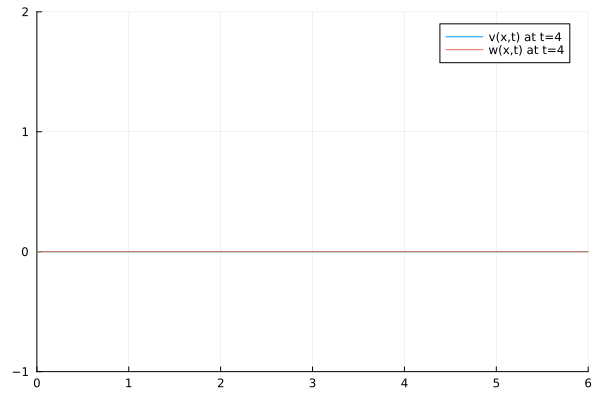

"c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\pdf\\images\\4-4.png"

In [344]:
graph = plot(xs, sol[1], xaxis=[a, b], yaxis=[-1, 2], label="v(x,t) at t=$T")
graph = plot!(xs, sol[2], label="w(x,t) at t=$T")

display(graph)
savefig(graph, joinpath("..", "pdf", "images", "4-4.png"))

# Problem 5

Repeat the previous problem with

\begin{align*}
    v(x,0) = 0, \quad w(x,0) = 0, \quad I_a(x) = 0.8 e^{-5x^2}.
\end{align*}

This should be a straightforward modification of the code if you've followed the outlined setup and will produce a periodic firing of traveling waves.

In [553]:
function TRBDF2_heat(U)
    Us = A1 \ (A2 * U)
    return A3 \ ((4 / 3) * Us - (1 / 3) * U)
end

TRBDF2_heat (generic function with 2 methods)

In [559]:
function gif_strange(V, W, T)
    anim = Animation()
    n = convert(Int64, ceil(T / k))

    plot(xs, V, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", T))
    plot!([a, b], [V[1], V[end]], label="BCs", seriestype=:scatter)
    plot!(xs, W, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", T))
    plot!([a, b], [W[1], W[end]], label="BCs", seriestype=:scatter)
    frame(anim)

    t = 0
    fr = 100
    n = convert(Int64, ceil(T / k))
    tb = convert(Int64, ceil(n / (fr * T)))
    for i = 2:n+1
        t += k

        #STRANGE SPLITTING
        V = TRBDF2_heat(V) #V=0
        W = RK2(V, W, k / 2)
        V = TRBDF2(V, W, k, 300, 1e-10) #V,W
        W = RK2(V, W, k / 2)
        V = TRBDF2_heat(V)

        if mod(i - 1, tb) ≈ 0.0
            plot(xs, V, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", t))
            plot!([a, b], [V[1], V[end]], label="BCs", seriestype=:scatter)
            plot!(xs, W, xaxis=[a, b], yaxis=[-1, 2], lw=3, label=@sprintf("u(x,t), t = %1.2f", t))
            plot!([a, b], [W[1], W[end]], label="BCs", seriestype=:scatter)
            frame(anim)
        end
    end
    gif(anim, "5.gif")
end

gif_strange (generic function with 2 methods)

In [560]:
function solve_strange(V, W, T)
    n = convert(Int64, ceil(T / k))
    for i = 2:n+1
        #STRANGE SPLITTING
        V = TRBDF2_heat(V) #V=0
        W = RK2(V, W, k / 2)
        V = TRBDF2(V, W, k, 300, 1e-10) #V,W
        W = RK2(V, W, k / 2)
        V = TRBDF2_heat(V)
    end
    return V, W
end

solve_strange (generic function with 1 method)

In [561]:
h = 0.02
k = h / 10
a = 0
b = 6
α = 0.3
β = 1
γ = 1
κ = 0.2
ϵ = 0.001
Ia = 0.8 * exp.(-5 * xs .^ 2)
T = 4

xs = a:h:b
m = length(xs) - 2

A = diagm(0 => fill(-2, m + 2), 1 => fill(1, m + 1), -1 => fill(1, m + 1)) |> sparse
A[1, 2] += 1
A[end, end-1] += 1
A *= κ / h^2

#k/2!!
A1 = I - (k / 8) * A
A2 = I + (k / 8) * A
A3 = I - (k / 6) * A;

┌ Info: Saved animation to c:\Users\admin\Documents\GitHub\UW\2022-2023\Spring\AMATH_586\Final Project\src\code\5.gif
└ @ Plots C:\Users\admin\.julia\packages\Plots\esM5q\src\animation.jl:156


Plots.AnimatedGif("c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\code\\5.gif")
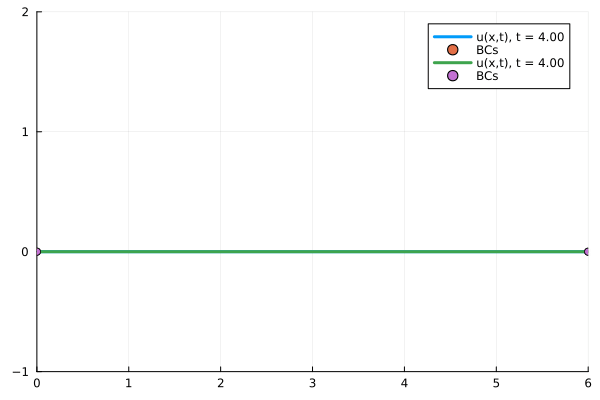

In [562]:
W = zeros(m + 2)
V = zeros(m + 2)
gif_strange(V, W, T)

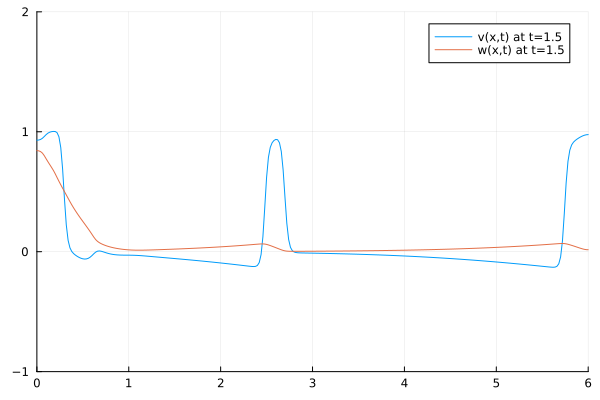

"c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\pdf\\images\\5-4.png"

In [362]:
T = 1.5
W = zeros(m + 2)
V = zeros(m + 2)

sol = solve_strange(V, W, T)

graph = plot(xs, sol[1], xaxis=[a, b], yaxis=[-1, 2], label="v(x,t) at t=$T")
graph = plot!(xs, sol[2], label="w(x,t) at t=$T")

display(graph)
savefig(graph, joinpath("..", "pdf", "images", "5-4.png"))

# Extra Credit Problem (5 points)

Consider the extension of the previous problem to two spatial dimensions: For $x \in (a,b), ~y \in (a,b)$:
\begin{align*}
v_t(x,y,t) &= \kappa v_{xx}(x,y,t) + \kappa v_{yy}(x,y,t)+  \frac 1 \epsilon \left( g(v(x,y,t)) - w(x,y,t) + I_a \right), \quad g(v) = v (\alpha - v) (v-1),\\
w_t(x,y,t) &= \beta v(x,y,t) - \gamma w(x,y,t).
\end{align*}

with initial and boundary data given by

\begin{align*}
v(x,y,0) = \eta(x,y) = \begin{cases} 1 & x < 2,\\
0 & \text{otherwise}, \end{cases} \quad w(x,y,0) = 0,\\
v_x(a,y,t) = v_x(b,y,t) = v_y(x,a,t) = v_y(x,b,t) = 0.
\end{align*}

The code we have created actually immediately generalizes to solve this problem.  Suppose that matrices `W` and `V` contain the spatial array of the values obeying the ordering in Figure 3.2(a).  For example, supposing that the grid spacing is the same in both directions the following code initializes `W` and `V`

```Julia
x = a:h:b |> Array
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x));
η = (x,y) -> x < 2 ? 1.0 : 0.0
V = map(η,X,Y)
W = 0*V
```

Then the Strang splitting scheme is given by

```Julia
V = TRBDF2_heat(V)
V = TRBDF2_heat(V')' |> Array
W = RK2(V,W,k/2)
V = TRBDF2(V,W,k)
W = RK2(V,W,k/2)
V = TRBDF2_heat(V)
V = TRBDF2_heat(V')' |> Array
```

The `|> Array` call just converts the transpose to a real array.  `Julia` has a special data type for the transpose of an array that allows for efficient memory usage but we will avoid using that here.  In `Matlab` or `Python` you wouldn't need an analogous call.

Set the parameters of the problem to be:

\begin{align*}
 a &= 0, \quad b = 12, \quad h = .05, \quad k = h/10, \quad \kappa = 1, \quad \epsilon = 0.01,\\
 \alpha &= 0.1, \quad \beta = 0.5, \quad \gamma = 1, \quad I_a = 0.
 \end{align*}

If you just solve with these parameters you should see a single pulse travel across the domain in the positive $x$-direction.


But if at time $t = 0.9$ zero out all elements of $V$ with associated $y$ coordinates being larger than $6$, you break the symmetry in the $y$-direction.  Solve until $t = 6$.  You should see a spiral wave develop!

In [545]:
function plot_heat(U, x, y, t, cl, width=800)
    p1 = surface(x, y, U[end:-1:1, :], xaxis=[0, 12], yaxis=[0, 12], zaxis=[cl[1], cl[2]], clims=cl, aspectratio=1, xlabel=L"x", ylabel=L"y", zlabel=L"u(x,y,t)")
    p2 = contour(x, y, U[end:-1:1, :], clims=cl, xaxis=[0, 12], yaxis=[0, 12], fill=true, aspectratio=1, xlabel=L"x", ylabel=L"y")
    plot(p1, p2, layout=2, size=(width, 7 * width / 10), title=@sprintf("t = %1.4f", t))
end

plot_heat (generic function with 2 methods)

In [548]:
function gif_strange(V, W, T, cut)
    n = convert(Int64, ceil(T / k))
    t = 0

    plot_heat(V, x, y, t, (-0.5, 1.5))

    anim = Animation()
    frame(anim)

    fr = 100
    n = convert(Int64, ceil(T / k))
    tb = convert(Int64, ceil(n / (fr * T)))
    for i = 2:n+1
        t += k

        if (t ≈ 0.9 && cut)
            ind = floor((m + 2) / 2) |> Int
            V[1:ind, :] = zeros(ind, m + 2)
        end

        #STRANGE SPLITTING
        V = TRBDF2_heat(V)
        V = TRBDF2_heat(V')' |> Array
        W = RK2(V, W, k / 2)
        V = TRBDF2(V, W, k, 300, 1e-10)
        W = RK2(V, W, k / 2)
        V = TRBDF2_heat(V)
        V = TRBDF2_heat(V')' |> Array #<- strange

        if mod(i - 1, tb) ≈ 0.0
            plot_heat(V, x, y, t, (-0.5, 1.5))
            frame(anim)
        end
    end
    #gif(anim, "6.gif")
    return anim
end 


gif_strange (generic function with 2 methods)

In [549]:
a = 0
b = 12
h = 0.05
k = h / 10
κ = 1
ϵ = 0.01
α = 0.1
β = 0.5
γ = 1
Ia = 0

xs = a:h:b
m = length(xs) - 2

A = diagm(0 => fill(-2, m + 2), 1 => fill(1, m + 1), -1 => fill(1, m + 1)) |> sparse
A[1, 2] += 1
A[end, end-1] += 1
A *= κ / h^2

#k/2!!
A1 = I - (k / 8) * A
A2 = I + (k / 8) * A
A3 = I - (k / 6) * A;

In [550]:
x = a:h:b |> Array
y = x
X = repeat(reshape(x, 1, :), length(y), 1)
Y = repeat(reverse(y), 1, length(x));
η = (x, y) -> x < 2 ? 1.0 : 0.0
V = map(η, X, Y)
W = 0 * V;

┌ Info: Saved animation to c:\Users\admin\Documents\GitHub\UW\2022-2023\Spring\AMATH_586\Final Project\src\code\6-1.gif
└ @ Plots C:\Users\admin\.julia\packages\Plots\esM5q\src\animation.jl:156


Plots.AnimatedGif("c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\code\\6-1.gif")
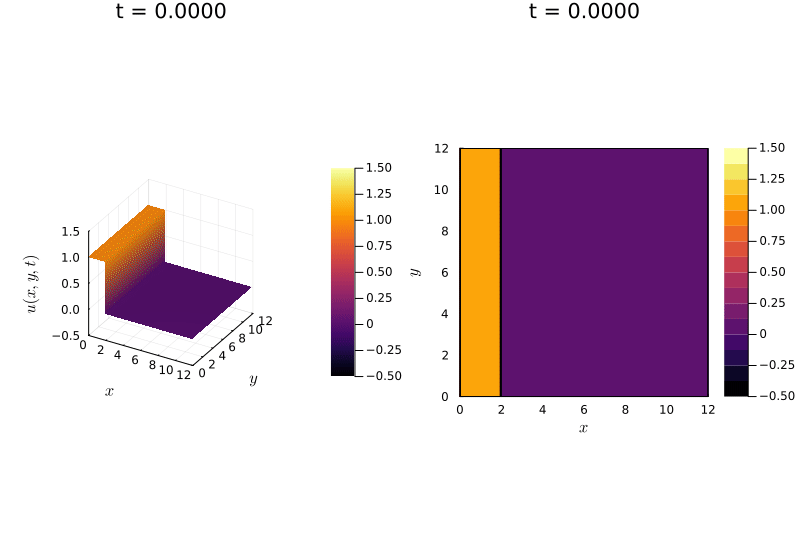

In [551]:
T = 2
anim = gif_strange(V, W, T, false)
gif(anim, "6-1.gif")

┌ Info: Saved animation to c:\Users\admin\Documents\GitHub\UW\2022-2023\Spring\AMATH_586\Final Project\src\code\6-2.gif
└ @ Plots C:\Users\admin\.julia\packages\Plots\esM5q\src\animation.jl:156


Plots.AnimatedGif("c:\\Users\\admin\\Documents\\GitHub\\UW\\2022-2023\\Spring\\AMATH_586\\Final Project\\src\\code\\6-2.gif")
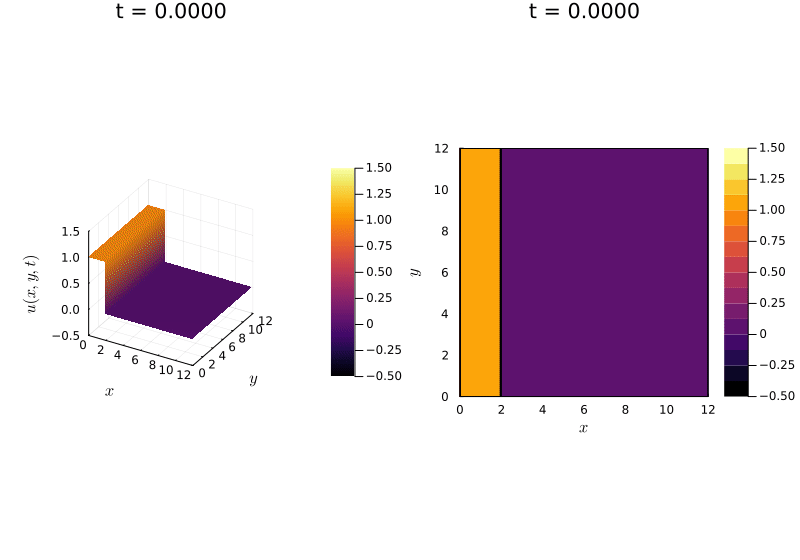

In [552]:
T = 6
anim = gif_strange(V, W, T, true)
gif(anim,"6-2.gif")